## 2D Linear Convection

This is very similar to step one, except we now have two spacial dimensions.

The relevant PDE is:

$$ \frac{\partial u}{\partial t} + c \frac{\partial u}{\partial x} + c \frac{\partial u}{\partial y} = 0 $$

Which is discretised to:

$$ u_{i,j}^{n+1} = u_{i,j}^n-c \frac{\Delta t}{\Delta x}(u_{i,j}^n-u_{i-1,j}^n)-c \frac{\Delta t}{\Delta y}(u_{i,j}^n-u_{i,j-1}^n) $$

And we will use the initial condition:

$$ u(x,y) = \begin{cases}
\begin{matrix}
2\ \text{for} & 0.5 \leq x, y \leq 1 \cr
1\ \text{for} & \text{everywhere else}\end{matrix}\end{cases} $$

And boundary condition:

$$ u = 1\ \text{for } \begin{cases}
\begin{matrix}
x =  0,\ 2 \cr
y =  0,\ 2 \end{matrix}\end{cases} $$

### Grid and Initial Conditions

Text(0.5, 0.92, 'Initial condition for 2D Linear Convection')

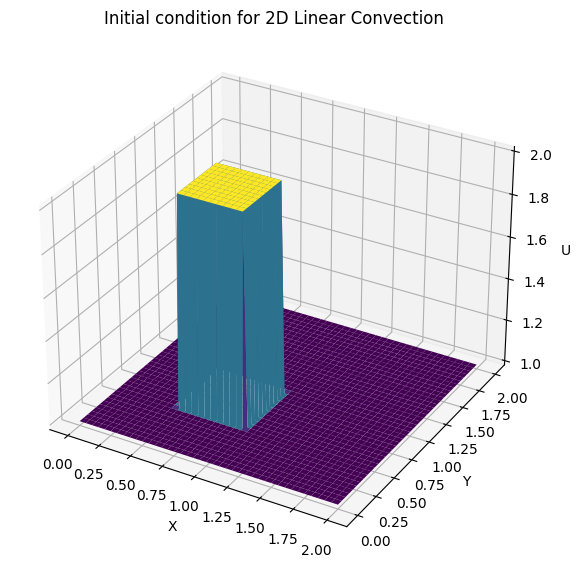

In [1]:
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from matplotlib import pyplot, cm
%matplotlib inline

#define our 2D grid, and get the time step using CFL condition to ensure convergence
x_len = 2
y_len = 2
num_x = 81
num_y = 81

num_t = 100

c = 1
sigma = 0.2

del_x = x_len / (num_x - 1)
del_y = y_len / (num_y - 1)
del_t = sigma * del_x

#set x, y, and assign initial conditions for u
x = np.linspace(0, x_len, num_x)
y = np.linspace(0, y_len, num_x)

u = np.ones((num_y, num_x))
u[ int(0.5 / del_y) : int(1 / del_y + 1) , int(0.5 / del_x) : int(1 / del_x +1) ] = 2

#plot the initial conditions
figure = pyplot.figure(figsize=(11, 7), dpi=100)
axes = figure.gca(projection='3d')
X, Y = np.meshgrid(x, y)
surface = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y')
axes.set_zlabel('U')
axes.set_title('Initial condition for 2D Linear Convection')

### Solve

Up until now, we have been using for loops to solve equations. Now we will start using Numpy array operations, which are much faster.

$$ u_{i,j}^{n+1} = u_{i,j}^n-c \frac{\Delta t}{\Delta x}(u_{i,j}^n-u_{i-1,j}^n)-c \frac{\Delta t}{\Delta y}(u_{i,j}^n-u_{i,j-1}^n) $$

Text(0.5, 0.92, '1D Linear Convection Solution')

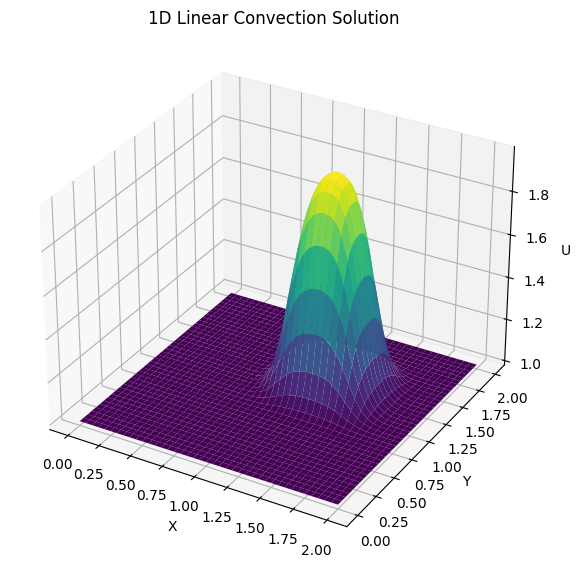

In [2]:
for n in range(num_t + 1):
    u_n = u.copy()
    
    #main computation
    u[1: , 1:] = u_n[1: , 1:] - c * del_t/del_x * (u_n[1: , 1:] - u_n[1: , :-1]) - \
                                c * del_t/del_y * (u_n[1: , 1:] - u_n[:-1 , 1:])
    
    #set the boundary conditions
    u[0, :] = 1
    u[-1, :] = 1
    u[: , 0] = 1
    u[: , -1] = 1
    
    
#plot in 3d
figure = pyplot.figure(figsize=(11, 7), dpi=100)
axes = figure.gca(projection='3d')
surface2 = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y')
axes.set_zlabel('U')
axes.set_title('2D Linear Convection Solution')

### Animation

Animation may not display if viewing on Github.

First, reset the initial conditions and generate a figure to animate on:

Text(0.5, 0.92, '2D Linear Convection Time Evolution')

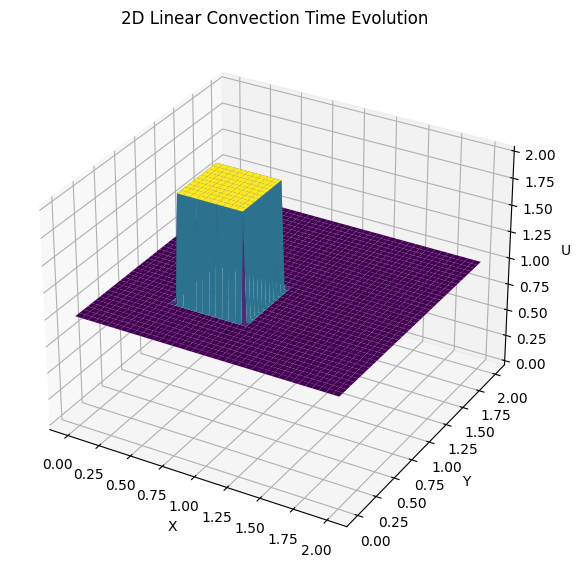

In [3]:
from matplotlib import animation, rc 
from IPython.display import HTML

#reset the initial conditions
u = np.ones((num_y, num_x))
u[ int(0.5 / del_y) : int(1 / del_y + 1) , int(0.5 / del_x) : int(1 / del_x +1) ] = 2

#generate the figure
figure = pyplot.figure(figsize=(11,7), dpi=100)
axes = figure.gca(projection='3d')

surface = axes.plot_surface(X, Y, u[:] , cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y');
axes.set_zlabel('U')
axes.set_zlim(0, 2)
axes.set_title('2D Linear Convection Time Evolution')

Now we can initialise and resolve, animating as we go:

In [4]:
def init_anim():
    axes.clear()
    surface = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
    return surface

def animate(j):
    u_n = u.copy()
    
    #main computation
    u[1: , 1:] = u_n[1: , 1:] - c * del_t/del_x * (u_n[1: , 1:] - u_n[1: , :-1]) - \
                                c * del_t/del_y * (u_n[1: , 1:] - u_n[:-1 , 1:])
    
    #set the boundary conditions
    u[0, :] = 1
    u[-1, :] = 1
    u[: , 0] = 1
    u[: , -1] = 1
    
    #add frame
    axes.clear()
    surface = axes.plot_surface(X, Y, u[:] , cmap=cm.viridis)
    axes.set_xlabel('X')
    axes.set_ylabel('Y');
    axes.set_zlabel('U')
    axes.set_zlim(0, 2)
    axes.set_title('2D Linear Convection Time Evolution')
    return surface

#so that we don't hit the animation embed limit
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

anim = animation.FuncAnimation(figure, animate, init_func=init_anim, frames=num_t, interval=20)
HTML(anim.to_jshtml())